## PyGMTSAR SBAS and PSI Analyses: Golden Valley, CA

The PyGMTSAR InSAR library, Geomed3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, among others, are my open-source projects developed in my free time. I hold a Master's degree in STEM, specializing in radio physics. In 2004, I received the first prize in the All-Russian Physics Competition for significant results in forward and inverse modeling for nonlinear optics and holography. These skills are also applicable to modeling Gravity, Magnetic, and Thermal fields, as well as satellite interferometry processing. With 20 years of experience as a data scientist and software developer, I have contributed to scientific and industrial development, working on government contracts, university projects, and with companies like LG Corp and Google Inc.

You can support my work on [Patreon](https://www.patreon.com/pechnikov), where I share updates on my projects, publications, use cases, examples, and other useful information. For research and development services and support, please visit my profile on the freelance platform [Upwork](https://www.upwork.com).

### Resources
- Google Colab Pro notebooks and articles on [Patreon](https://www.patreon.com/pechnikov),
- Google Colab notebooks on [GitHub](https://github.com),
- Docker Images on [DockerHub](https://hub.docker.com),
- Geological Models on [YouTube](https://www.youtube.com),
- VR/AR Geological Models on [GitHub](https://github.com),
- Live updates and announcements on [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/).

© Alexey Pechnikov, 2024

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Load Modules to Check Environment

In [142]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [143]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !export DEBIAN_FRONTEND=noninteractive
        !apt-get update > /dev/null
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt  > /dev/null
        # GMTSAR codes are not so good to be compiled by modern GCC
        !apt install gcc-9 > /dev/null
        !update-alternatives --install /usr/bin/gcc gcc /usr/bin/gcc-9 10
        !update-alternatives --config gcc
        !gcc --version | head -n 1
        !rm -fr /usr/local/GMTSAR
        !git config --global advice.detachedHead false
        !cd /usr/local && git clone -q --branch master https://github.com/gmtsar/gmtsar GMTSAR
        # revert recent broken commit
        !cd /usr/local/GMTSAR && git checkout e98ebc0f4164939a4780b1534bac186924d7c998 > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null
        # fix for missed script, use bash instead of csh interpretator
        # note: csh messes stdout and stderr in Docker environment, it's resolved in PyGMTSAR code
        !echo '#!/bin/sh' > /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !echo echo /usr/local/GMTSAR/share/gmtsar >> /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !chmod a+x /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !/usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        # test one GMTSAR binary
        !/usr/local/GMTSAR/bin/make_s1a_tops 2>&1 | head -n 2

In [144]:
import sys
if 'google.colab' in sys.modules:
    !apt install -y xvfb > /dev/null
    !{sys.executable} -m pip install pyvista xvfbwrapper > /dev/null
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

### Define ENV Variables for Jupyter Instance

In [145]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

### Install Python Modules

Maybe you need to restart your notebook, follow the instructions printing below.

The installation takes a long time on fresh Debian 10 and a short time on Google Colab

In [146]:
!{sys.executable} --version

Python 3.10.12


In [147]:
if 'google.colab' in sys.modules:
    #!{sys.executable} -m pip install -Uq git+https://github.com/mobigroup/gmtsar.git@pygmtsar2#subdirectory=pygmtsar
    !{sys.executable} -m pip install -q pygmtsar
from pygmtsar import __version__
__version__

'2024.2.20'

## Load and Setup Python Modules

In [148]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import json
from dask.distributed import Client
import dask
import warnings
warnings.filterwarnings('ignore')

In [149]:
# plotting modules
import pyvista as pv
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension('vtk')
from contextlib import contextmanager
import matplotlib.pyplot as plt
@contextmanager
def mpl_settings(settings):
    original_settings = {k: plt.rcParams[k] for k in settings}
    plt.rcParams.update(settings)
    yield
    plt.rcParams.update(original_settings)
plt.rcParams['figure.figsize'] = [12, 4]
plt.rcParams['figure.dpi'] = 150
plt.rcParams['figure.titlesize'] = 24
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
%matplotlib inline

In [150]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 100)

In [151]:
from pygmtsar import S1, Stack, tqdm_dask, NCubeVTK, ASF, XYZTiles
if os.path.exists('/.dockerenv') and not 'google.colab' in sys.modules:
    # use different NetCDF backend in Docker containers
    from pygmtsar import datagrid
    datagrid.netcdf_engine = 'netcdf4'

## Define Sentinel-1 SLC Scenes and Processing Parameters

When you need more scenes and SBAS analysis  see examples on PyGMTSAR GitHub page https://github.com/mobigroup/gmtsar

### Descending Orbit Configuration

In [152]:
SCENES = """
S1A_IW_SLC__1SDV_20211220T135243_20211220T135311_041093_04E1C6_571D
S1A_IW_SLC__1SDV_20211208T135244_20211208T135312_040918_04DBF1_5BB3
S1A_IW_SLC__1SDV_20211126T135244_20211126T135312_040743_04D5D8_F7BC
S1A_IW_SLC__1SDV_20211114T135245_20211114T135313_040568_04CFD7_582A
S1A_IW_SLC__1SDV_20211102T135245_20211102T135313_040393_04C9B8_06BA
S1A_IW_SLC__1SDV_20211021T135246_20211021T135313_040218_04C3A1_AC92
S1A_IW_SLC__1SDV_20211009T135246_20211009T135313_040043_04BD89_8A1C
S1A_IW_SLC__1SDV_20210927T135246_20210927T135313_039868_04B77E_080A
S1A_IW_SLC__1SDV_20210915T135245_20210915T135312_039693_04B182_B51B
S1A_IW_SLC__1SDV_20210903T135245_20210903T135312_039518_04AB89_6CBC
S1A_IW_SLC__1SDV_20210822T135244_20210822T135311_039343_04A583_7922
S1A_IW_SLC__1SDV_20210810T135244_20210810T135311_039168_049F83_A317
S1A_IW_SLC__1SDV_20210729T135243_20210729T135310_038993_0499C7_1A1B
S1A_IW_SLC__1SDV_20210717T135242_20210717T135309_038818_049496_0ABE
S1A_IW_SLC__1SDV_20210705T135242_20210705T135309_038643_048F59_0F30
S1A_IW_SLC__1SDV_20210623T135241_20210623T135308_038468_048A0E_7E2B
S1A_IW_SLC__1SDV_20210611T135240_20210611T135307_038293_0484D8_D775
S1A_IW_SLC__1SDV_20210530T135240_20210530T135306_038118_047FAA_A70D
S1A_IW_SLC__1SDV_20210518T135239_20210518T135306_037943_047A68_660C
S1A_IW_SLC__1SDV_20210506T135238_20210506T135305_037768_047520_2C81
S1A_IW_SLC__1SDV_20210424T135238_20210424T135305_037593_046F1A_82DC
S1A_IW_SLC__1SDV_20210412T135237_20210412T135304_037418_046911_7DB6
S1A_IW_SLC__1SDV_20210331T135237_20210331T135304_037243_046307_91F1
S1A_IW_SLC__1SDV_20210319T135236_20210319T135303_037068_045CFB_34F9
S1A_IW_SLC__1SDV_20210307T135236_20210307T135303_036893_0456E2_0C1D
S1A_IW_SLC__1SDV_20210223T135236_20210223T135303_036718_0450C6_883C
S1A_IW_SLC__1SDV_20210211T135237_20210211T135304_036543_044AAA_DAE0
S1A_IW_SLC__1SDV_20210130T135237_20210130T135304_036368_04449D_30E3
S1A_IW_SLC__1SDV_20210118T135237_20210118T135304_036193_043E88_5815
S1A_IW_SLC__1SDV_20210106T135238_20210106T135305_036018_043864_D0B4
"""
SCENES = list(filter(None, SCENES.split('\n')))
print (f'Scenes defined: {len(SCENES)}')

ORBIT     = 'D'
SUBSWATH  = 3
REFERENCE = '2021-07-05'

Scenes defined: 30


In [153]:
WORKDIR = 'raw_golden_desc'  if ORBIT == 'D' else 'raw_golden_asc'
DATADIR = 'data_golden_desc' if ORBIT == 'D' else 'data_golden_asc'

In [154]:
geojson = '''
{
  "type": "Feature",
  "properties": {},
  "geometry": {
    "type": "Polygon",
    "coordinates": [
      [
        [-118.4711, 34.3916],
        [-118.47, 34.3915],
        [-118.4688, 34.3916],
        [-118.467, 34.3921],
        [-118.4658, 34.3924],
        [-118.4646, 34.3928],
        [-118.4629, 34.3936],
        [-118.461, 34.3942],
        [-118.4578, 34.3939],
        [-118.4595, 34.399],
        [-118.46, 34.3994],
        [-118.4631, 34.3976],
        [-118.4674, 34.3952],
        [-118.469, 34.394],
        [-118.4699, 34.3934],
        [-118.471, 34.3926],
        [-118.4717, 34.3918],
        [-118.4711, 34.3916]
      ]
    ]
  }
}
'''
AOI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
AOI

,geometry
0,"POLYGON ((-118.47110 34.39160, -118.47000 34.39150, -118.46880 34.39160, -118.46700 34.39210, -1..."


In [155]:
BUFFER = 0.025
# geometry is too small for the processing, enlarge it
AOI['geometry'] = AOI.buffer(BUFFER)

In [156]:
# subsidence point from https://blog.descarteslabs.com/sentinel-1-targeted-analysis
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [-118.4652, 34.3952]
  },
  "properties": {}
}
'''
POI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI

,geometry
0,POINT (-118.46520 34.39520)


In [157]:
# reference point from https://blog.descarteslabs.com/sentinel-1-targeted-analysis
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [-118.4629,34.3946]
  },
  "properties": {}
}
'''
POI0 = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI0

,geometry
0,POINT (-118.46290 34.39460)


## Download and Unpack Datasets

## Enter Your ASF (Earthdata) User and Password

If the data directory is empty or doesn't exist, you'll need to download Sentinel-1 scenes from the Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you don't have an Earthdata Login, you can create one at https://urs.earthdata.nasa.gov//users/new

You can also use pre-existing SLC scenes stored on your Google Drive, or you can copy them using a direct public link from iCloud Drive.

The credentials below are available at the time the notebook is validated. Special symbols, like underscores, are required in your ASF password.

In [158]:
# Set these variables to None and you will be prompted to enter your username and password below.
username = 'GoogleColab2023'
password = 'GoogleColab_2023'

In [159]:
# download required polarization and subswaths only
asf = ASF(username, password)
asf.download(DATADIR, SCENES, SUBSWATH)

## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [160]:
# simple Dask initialization
if 'client' in globals():
    client.close()
client = Client()
client

INFO:distributed.scheduler:Scheduler closing due to unknown reason...
INFO:distributed.scheduler:Scheduler closing all comms
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:46851
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:8787/status
INFO:distributed.scheduler:Registering Worker plugin shuffle
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:35207', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:35207
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35504
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:36941', name: 0, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:36941
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35514
INFO:distributed.scheduler:Receive client connection:

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 2
Total threads: 2,Total memory: 12.67 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:46851,Workers: 2
Dashboard: http://127.0.0.1:8787/status,Total threads: 2
Started: Just now,Total memory: 12.67 GiB
Comm: tcp://127.0.0.1:36941,Total threads: 1
Dashboard: http://127.0.0.1:38201/status,Memory: 6.34 GiB
Nanny: tcp://127.0.0.1:40243,


## Init

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Select Original Secenes and Orbits

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [161]:
scenes = S1.scan_slc(DATADIR, subswath=SUBSWATH)

In [162]:
sbas = Stack(WORKDIR, drop_if_exists=True).set_scenes(scenes).set_reference(REFERENCE)
sbas.to_dataframe()

NOTE: auto set reference scene 2021-01-06. You can change it like Stack.set_reference("2022-01-20")


,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2021-01-06,2021-01-06 13:52:38,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210106T135238_20210106T135305_036018_043864_D0B4.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210106T135238_20210106T135305_036018_043864_D0B4.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210319T040939_V20210105T225942_20210107T005942.EOF,"MULTIPOLYGON (((-118.17292 34.49335, -118.21655 34.49958, -118.26423 34.50638, -118.30973 34.512..."
2021-01-18,2021-01-18 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210118T135237_20210118T135304_036193_043E88_5815.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210118T135237_20210118T135304_036193_043E88_5815.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210207T122351_V20210117T225942_20210119T005942.EOF,"MULTIPOLYGON (((-118.17358 34.49299, -118.21721 34.49922, -118.26489 34.50601, -118.31039 34.512..."
2021-01-30,2021-01-30 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210130T135237_20210130T135304_036368_04449D_30E3.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210130T135237_20210130T135304_036368_04449D_30E3.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210219T121824_V20210129T225942_20210131T005942.EOF,"MULTIPOLYGON (((-118.17513 34.49361, -118.21875 34.49985, -118.26643 34.50664, -118.31194 34.513..."
2021-02-11,2021-02-11 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210211T135237_20210211T135304_036543_044AAA_DAE0.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210211T135237_20210211T135304_036543_044AAA_DAE0.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210303T121819_V20210210T225942_20210212T005942.EOF,"MULTIPOLYGON (((-118.17554 34.49288, -118.21916 34.49912, -118.26684 34.50591, -118.31234 34.512..."
2021-02-23,2021-02-23 13:52:36,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210223T135236_20210223T135303_036718_0450C6_883C.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210223T135236_20210223T135303_036718_0450C6_883C.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210315T122326_V20210222T225942_20210224T005942.EOF,"MULTIPOLYGON (((-118.17410 34.49324, -118.21772 34.49948, -118.26540 34.50627, -118.31090 34.512..."
2021-03-07,2021-03-07 13:52:36,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210307T135236_20210307T135303_036893_0456E2_0C1D.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210307T135236_20210307T135303_036893_0456E2_0C1D.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210327T121833_V20210306T225942_20210308T005942.EOF,"MULTIPOLYGON (((-118.17365 34.49309, -118.21728 34.49933, -118.26495 34.50612, -118.31045 34.512..."
2021-03-19,2021-03-19 13:52:36,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210319T135236_20210319T135303_037068_045CFB_34F9.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210319T135236_20210319T135303_037068_045CFB_34F9.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210408T121914_V20210318T225942_20210320T005942.EOF,"MULTIPOLYGON (((-118.17341 34.49356, -118.21703 34.49980, -118.26470 34.50659, -118.31020 34.513..."
2021-03-31,2021-03-31 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210331T135237_20210331T135304_037243_046307_91F1.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210331T135237_20210331T135304_037243_046307_91F1.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210420T121836_V20210330T225942_20210401T005942.EOF,"MULTIPOLYGON (((-118.17442 34.49315, -118.21804 34.49939, -118.26571 34.50618, -118.31121 34.512..."
2021-04-12,2021-04-12 13:52:37,D,S1A,VV,3,data_golden_desc/S1A_IW_SLC__1SDV_20210412T135237_20210412T135304_037418_046911_7DB6.SAFE/measur...,data_golden_desc/S1A_IW_SLC__1SDV_20210412T135237_20210412T135304_037418_046911_7DB6.SAFE/annota...,data_golden_desc/S1A_OPER_AUX_POEORB_OPOD_20210502T121625_V20210411T225942_20210413T005942.EOF,"MULTIPOLYGON (((-118.17499 34.49339, -118.21862 34.49

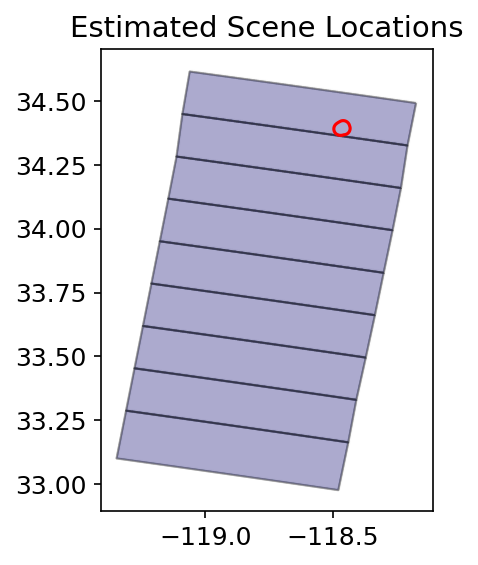

In [163]:
sbas.plot_scenes(AOI=AOI)

## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

In [164]:
sbas.compute_reframe(AOI)

Reframing:   0%|          | 0/30 [00:00<?, ?it/s]

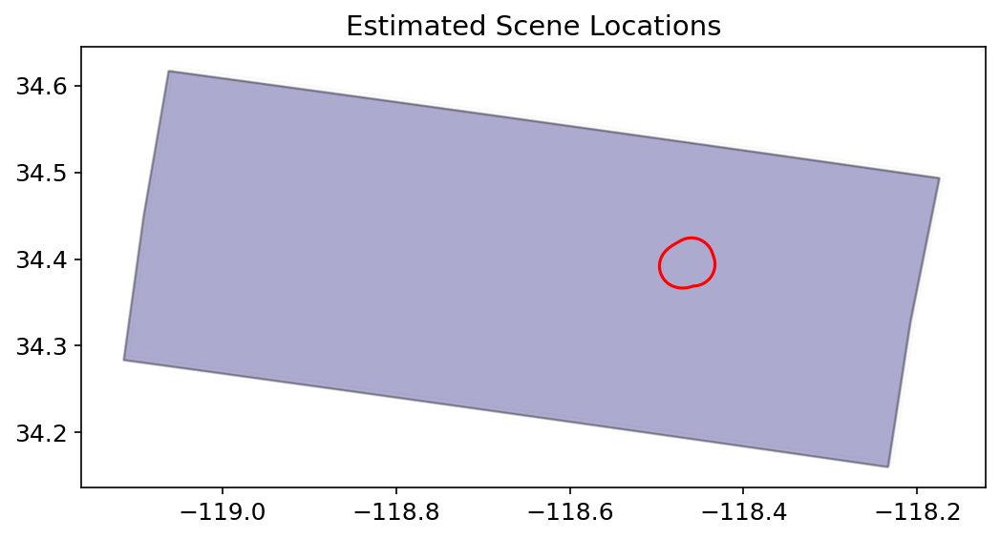

In [165]:
sbas.plot_scenes(AOI=AOI)

### Download SRTM DEM

The function below downloads SRTM1 or SRTM3 DEM and converts heights to ellipsoidal model using EGM96 grid.
Besides, for faster processing we can use pre-defined DEM file as explained above. Select product=SRTM1 for 30m resolution and product=SRTM3 for 90m resolution SRTM DEM.

In [166]:
# define the area of interest (AOI) to speedup the processing
sbas.download_dem(AOI)

DEM Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

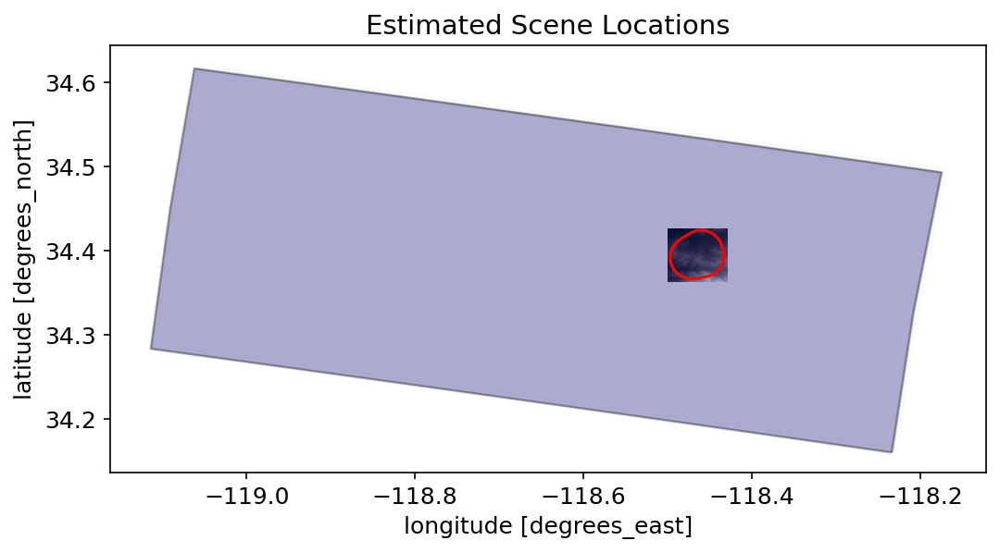

In [167]:
sbas.plot_scenes(AOI=AOI)

## Align Images

In [168]:
if os.path.exists('/.dockerenv') and not 'google.colab' in sys.modules:
    # use special joblib backend in Docker containers
    sbas.compute_align(joblib_aligning_backend='threading')
else:
    sbas.compute_align()

Aligning Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning Repeat:   0%|          | 0/29 [00:00<?, ?it/s]

Convert Subswath:   0%|          | 0/30 [00:00<?, ?it/s]

## Backup

In [169]:
# bursts-cropped GeoTIFF files moved into backup directory
sbas.backup('backup')

In [170]:
# free disk space removing the cropped Sentinel-1 GeoTIFFs
# alternatively, drop the data directory and use the backup
!rm -fr backup

## Geocoding Transform

In [171]:
# use the original Sentinel-1 resolution (1 pixel spacing)
sbas.compute_geocode(1)

Radar Transform Computing:   0%|          | 0/1 [00:00<?, ?it/s]

Radar Transform Saving:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-fdf0ab28-d0d8-11ee-949c-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:56080
INFO:distributed.scheduler:Receive client connection: Client-worker-fdf81c2d-d0d8-11ee-949e-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:56092
ERROR:asyncio:Task exception was never retrieved
future: <Task finished name='Task-5340662' coro=<Client._gather.<locals>.wait() done, defined at /usr/local/lib/python3.10/dist-packages/distributed/client.py:2208> exception=AllExit()>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/distributed/client.py", line 2217, in wait
    raise AllExit()
distributed.client.AllExit
ERROR:asyncio:Task exception was never retrieved
future: <Task finished name='Task-5380088' coro=<Client._gather.<locals>.wait() done, defined at /usr/local/lib/python3.10/dist-packages/distributed/client.py:2208> exception=

Radar Transform Indexing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Inverse Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

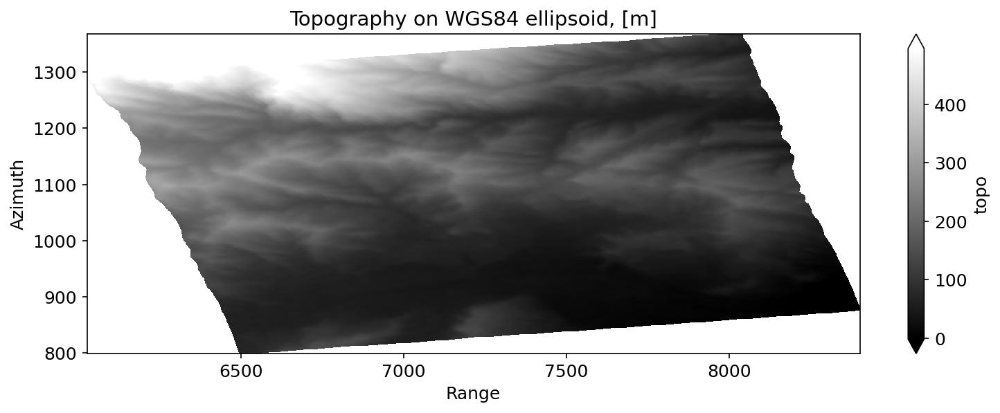

In [172]:
sbas.plot_topo(quantile=[0.01, 0.99])

## SBAS Baseline

In [173]:
baseline_pairs = sbas.sbas_pairs(days=24)
# optionally, drop dates having less then 2 pairs
#baseline_pairs = sbas.sbas_pairs_limit(baseline_pairs, limit=2, iterations=2)
# optionally, drop all pairs connected to the specified dates
#baseline_pairs = sbas.sbas_pairs_filter_dates(baseline_pairs, ['2021-01-01'])
baseline_pairs

,ref,rep,ref_baseline,rep_baseline,pair,baseline,duration,rel
0,2021-01-06,2021-01-18,-49.87,-5.13,2021-01-06 2021-01-18,44.74,12,NaT
1,2021-01-06,2021-01-30,-49.87,114.28,2021-01-06 2021-01-30,164.15,24,NaT
2,2021-01-18,2021-01-30,-5.13,114.28,2021-01-18 2021-01-30,119.41,12,NaT
3,2021-01-18,2021-02-11,-5.13,126.08,2021-01-18 2021-02-11,131.21,24,NaT
4,2021-01-30,2021-02-11,114.28,126.08,2021-01-30 2021-02-11,11.80,12,NaT
5,2021-01-30,2021-02-23,114.28,-2.63,2021-01-30 2021-02-23,-116.91,24,NaT
6,2021-02-11,2021-02-23,126.08,-2.63,2021-02-11 2021-02-23,-128.71,12,NaT
7,2021-02-11,2021-03-07,126.08,-61.22,2021-02-11 2021-03-07,-187.30,24,NaT
8,2021-02-23,2021-03-07,-2.63,-61.22,2021-02-23 2021-03-07,-58.59,12,NaT
9,2021-02-23,2021-03-19,-2.63,-93.34,2021-02-23 2021-03-19,-90.71,24,NaT


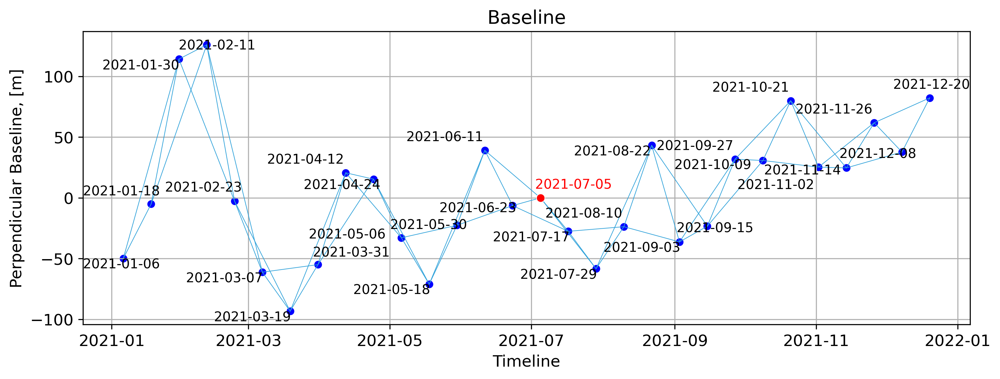

In [174]:
with mpl_settings({'figure.dpi': 300}):
    sbas.plot_baseline(baseline_pairs)

## Persistent Scatterers Function (PSF)

In [175]:
# use the only selected dates for the pixels stability analysis
sbas.compute_ps()

Intensity Normalization:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Compute Stability Measures:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

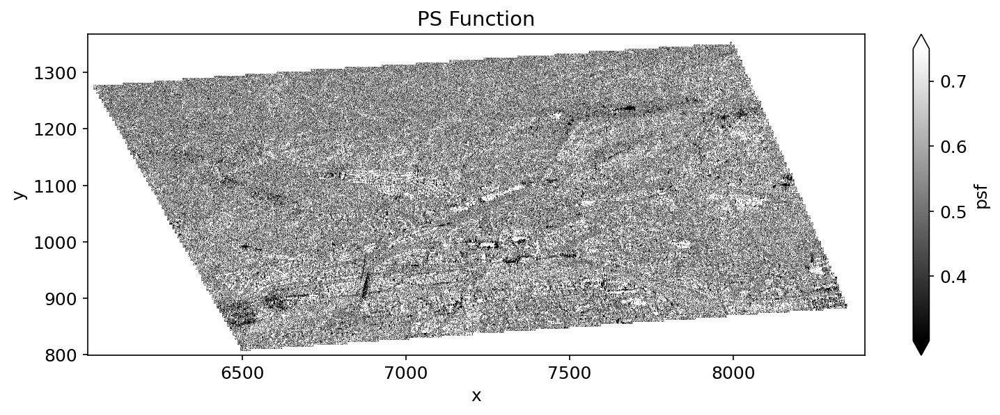

In [176]:
sbas.plot_psfunction(quantile=[0.01, 0.90])

## SBAS Analysis

### Multi-looked Resolution for SBAS

In [177]:
sbas.compute_interferogram_multilook(baseline_pairs, 'intf_mlook', wavelength=30, weight=sbas.psfunction())

Saving Interferogram 01...19 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 20...38 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 39...57 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [178]:
# optionally, materialize to disk and open
ds_sbas = sbas.open_stack('intf_mlook')
intf_sbas = ds_sbas.phase
corr_sbas = ds_sbas.correlation
corr_sbas

<xarray.DataArray 'correlation' (pair: 57, y: 569, x: 594)> Size: 77MB
dask.array<concatenate, shape=(57, 569, 594), dtype=float32, chunksize=(1, 569, 594), chunktype=numpy.ndarray>
Coordinates:
  * pair     (pair) <U21 5kB '2021-01-06 2021-01-18' ... '2021-12-08 2021-12-20'
    ref      (pair) datetime64[ns] 456B 2021-01-06 2021-01-06 ... 2021-12-08
    rep      (pair) datetime64[ns] 456B 2021-01-18 2021-01-30 ... 2021-12-20
  * y        (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.366e+03 1.368e+03
  * x        (x) float64 5kB 6.028e+03 6.032e+03 6.036e+03 ... 8.396e+03 8.4e+03

In [179]:
intf_sbas

<xarray.DataArray 'phase' (pair: 57, y: 569, x: 594)> Size: 77MB
dask.array<concatenate, shape=(57, 569, 594), dtype=float32, chunksize=(1, 569, 594), chunktype=numpy.ndarray>
Coordinates:
  * pair     (pair) <U21 5kB '2021-01-06 2021-01-18' ... '2021-12-08 2021-12-20'
    ref      (pair) datetime64[ns] 456B 2021-01-06 2021-01-06 ... 2021-12-08
    rep      (pair) datetime64[ns] 456B 2021-01-18 2021-01-30 ... 2021-12-20
  * y        (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.366e+03 1.368e+03
  * x        (x) float64 5kB 6.028e+03 6.032e+03 6.036e+03 ... 8.396e+03 8.4e+03

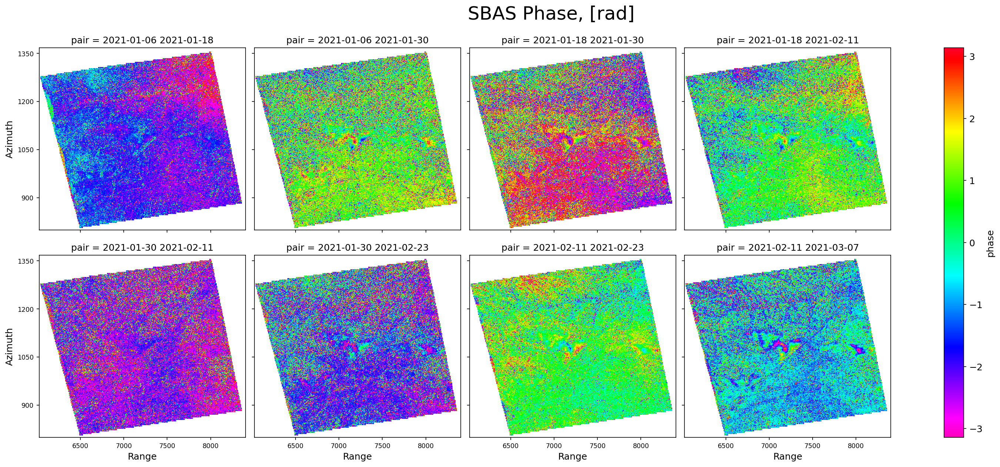

In [180]:
sbas.plot_interferograms(intf_sbas[:8], caption='SBAS Phase, [rad]')

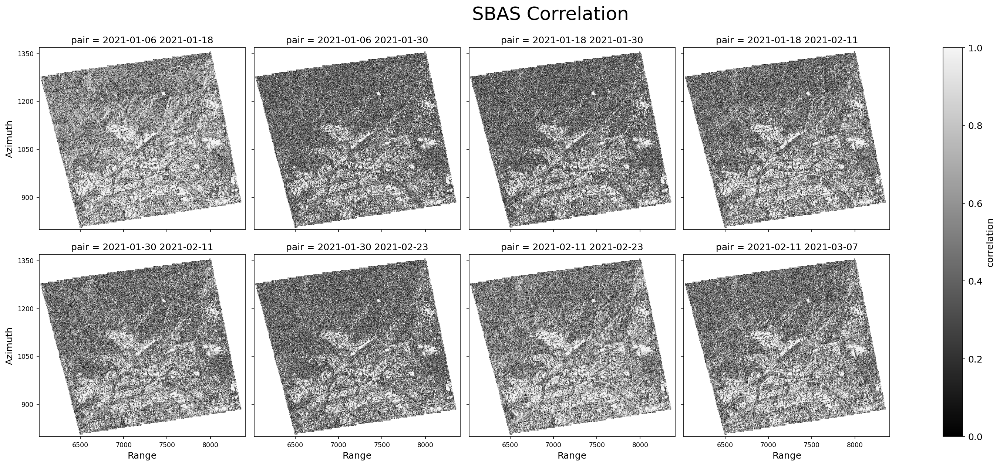

In [181]:
sbas.plot_correlations(corr_sbas[:8], caption='SBAS Correlation')

### 2D Unwrapping

In [182]:
unwrap_sbas = sbas.unwrap_snaphu(intf_sbas, corr_sbas)
unwrap_sbas

<xarray.Dataset> Size: 77MB
Dimensions:  (pair: 57, y: 569, x: 594)
Coordinates:
  * pair     (pair) <U21 5kB '2021-01-06 2021-01-18' ... '2021-12-08 2021-12-20'
    ref      (pair) datetime64[ns] 456B 2021-01-06 2021-01-06 ... 2021-12-08
    rep      (pair) datetime64[ns] 456B 2021-01-18 2021-01-30 ... 2021-12-20
  * y        (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.366e+03 1.368e+03
  * x        (x) float64 5kB 6.028e+03 6.032e+03 6.036e+03 ... 8.396e+03 8.4e+03
Data variables:
    phase    (pair, y, x) float32 77MB dask.array<chunksize=(1, 569, 594), meta=np.ndarray>

In [183]:
# optionally, materialize to disk and open
unwrap_sbas = sbas.sync_cube(unwrap_sbas, 'unwrap_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

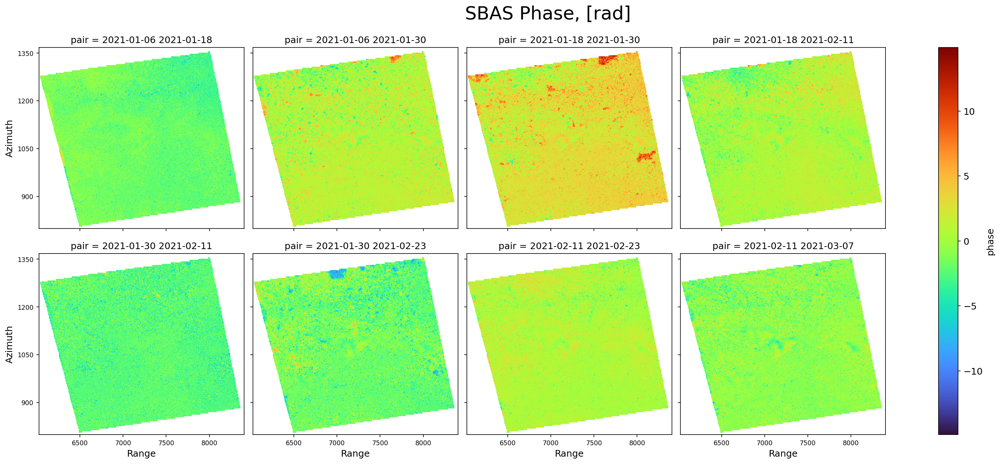

In [184]:
sbas.plot_phases(unwrap_sbas.phase[:8], caption='SBAS Phase, [rad]')

### Trend Correction

In [185]:
decimator = sbas.decimator(resolution=15, grid=(1,1))
topo = decimator(sbas.get_topo())
inc = decimator(sbas.incidence_angle())
yy, xx = xr.broadcast(topo.y, topo.x)
trend_sbas = sbas.regression(unwrap_sbas.phase,
        [topo,    topo*yy,    topo*xx,    topo*yy*xx,
         topo**2, topo**2*yy, topo**2*xx, topo**2*yy*xx,
         topo**3, topo**3*yy, topo**3*xx, topo**3*yy*xx,
         inc,     inc**yy,    inc*xx,     inc*yy*xx,
         yy, xx,
         yy**2, xx**2, yy*xx,
         yy**3, xx**3, yy**2*xx, xx**2*yy], corr_sbas)

In [186]:
# optionally, materialize to disk and open
trend_sbas = sbas.sync_cube(trend_sbas, 'trend_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

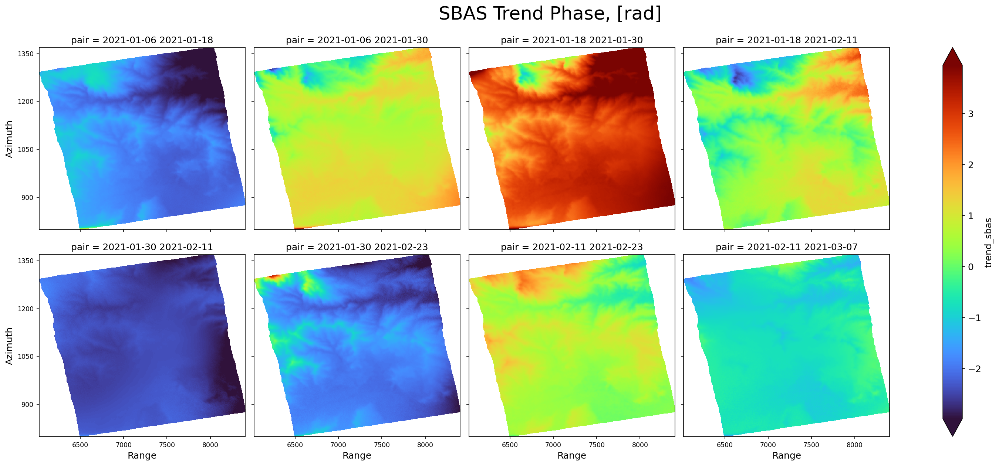

In [187]:
sbas.plot_phases(trend_sbas[:8], caption='SBAS Trend Phase, [rad]', quantile=[0.01, 0.99])

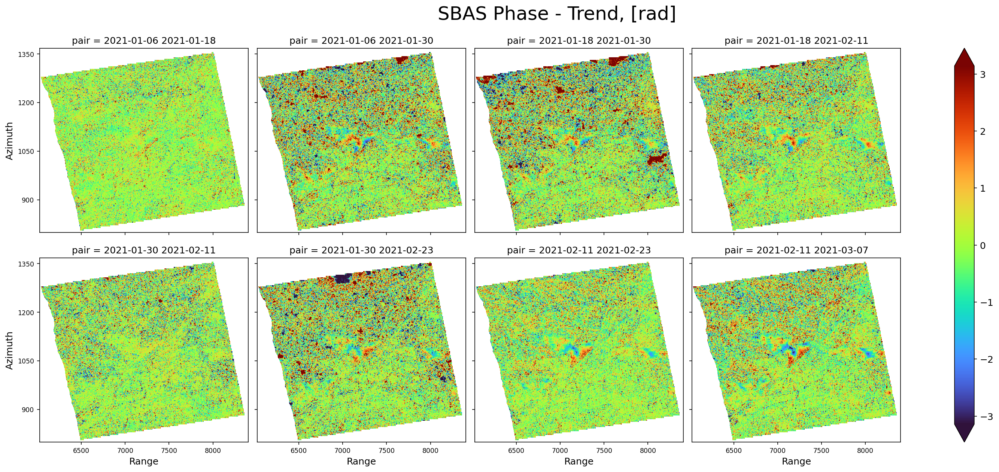

In [188]:
sbas.plot_phases((unwrap_sbas.phase - trend_sbas)[:8], caption='SBAS Phase - Trend, [rad]', vmin=-np.pi, vmax=np.pi)

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [189]:
# calculate phase displacement in radians and convert to LOS displacement in millimeter
disp_sbas = sbas.los_displacement_mm(sbas.lstsq(unwrap_sbas.phase - trend_sbas, corr_sbas))

Note: data chunk size (569, 594) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


In [190]:
# optionally, materialize to disk and open
disp_sbas = sbas.sync_cube(disp_sbas, 'disp_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

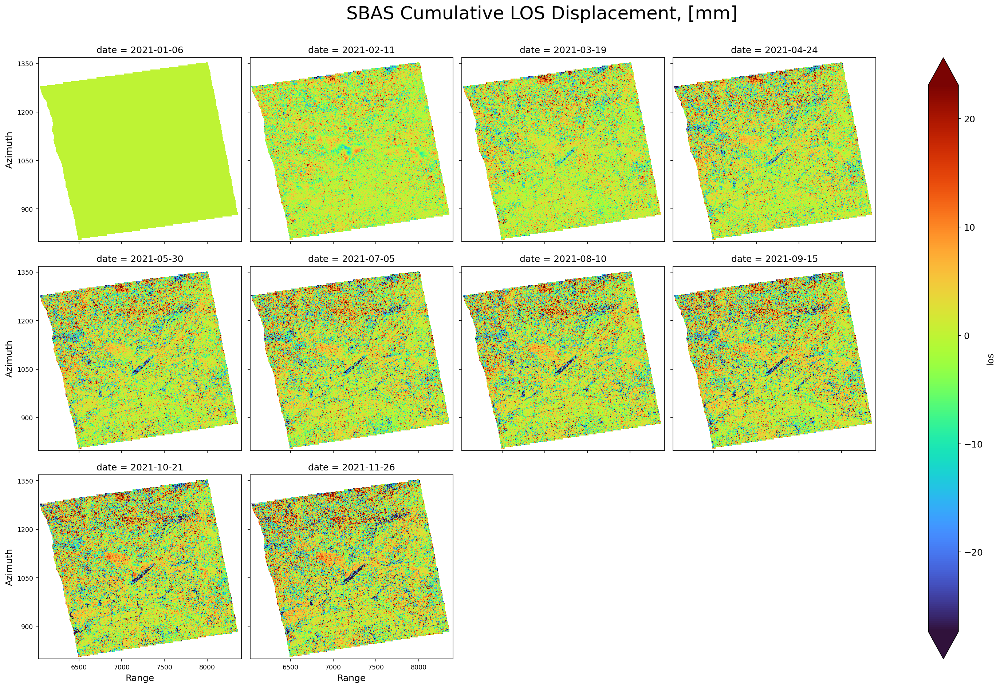

In [191]:
sbas.plot_displacements(disp_sbas[::3], caption='SBAS Cumulative LOS Displacement, [mm]', quantile=[0.01, 0.99])

### STL model for LOS Displacement, mm

In [192]:
stl_sbas = sbas.stl(disp_sbas)
stl_sbas

Note: data chunk size (569, 594) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.Dataset> Size: 203MB
Dimensions:   (date: 50, y: 569, x: 594)
Coordinates:
  * date      (date) datetime64[ns] 400B 2021-01-10 2021-01-17 ... 2021-12-19
  * y         (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.368e+03
  * x         (x) float64 5kB 6.028e+03 6.032e+03 ... 8.396e+03 8.4e+03
Data variables:
    trend     (date, y, x) float32 68MB dask.array<chunksize=(50, 256, 256), meta=np.ndarray>
    seasonal  (date, y, x) float32 68MB dask.array<chunksize=(50, 256, 256), meta=np.ndarray>
    resid     (date, y, x) float32 68MB dask.array<chunksize=(50, 256, 256), meta=np.ndarray>

In [193]:
# optionally, materialize to disk and open
stl_sbas = sbas.sync_cube(stl_sbas, 'stl_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [194]:
years = ((stl_sbas.date.max() - stl_sbas.date.min()).dt.days/365.25).item()
print ('years', np.round(years, 3))
velocity_sbas = stl_sbas.trend.mean('date')/years
velocity_sbas

years 0.939


<xarray.DataArray 'trend' (y: 569, x: 594)> Size: 1MB
dask.array<truediv, shape=(569, 594), dtype=float32, chunksize=(569, 594), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.366e+03 1.368e+03
  * x        (x) float64 5kB 6.028e+03 6.032e+03 6.036e+03 ... 8.396e+03 8.4e+03

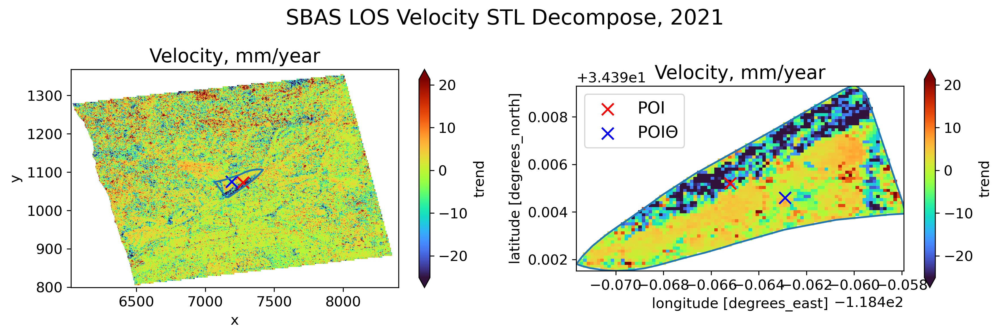

In [195]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_sbas, [0.01, 0.99])

ax = fig.add_subplot(1, 2, 1)
velocity_sbas.plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
sbas.geocode(AOI.buffer(-BUFFER).boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
sbas.geocode(POI0).plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.set_aspect('auto')
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.clip(AOI.geometry.buffer(-BUFFER))\
    .plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
AOI.buffer(-BUFFER).boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
POI0.plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('SBAS LOS Velocity STL Decompose, 2021', fontsize=18)
plt.tight_layout()
plt.show()

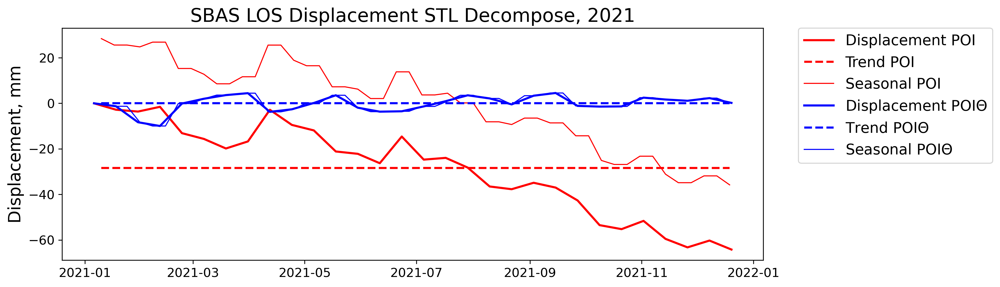

In [196]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_sbas.sel(y=y, x=x, method='nearest')
stl_pixel = stl_sbas.sel(y=y, x=x, method='nearest')
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = disp_sbas.sel(y=y, x=x, method='nearest')
stl_pixel = stl_sbas.sel(y=y, x=x, method='nearest')
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title('SBAS LOS Displacement STL Decompose, 2021', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.show()

## PS Analysis

Use the trend detected on possibly lower resolution unwrapped phases for higher resolution analysis.

In [197]:
sbas.compute_interferogram_singlelook(baseline_pairs, 'intf_slook', wavelength=30,
                                      weight=sbas.psfunction(), phase=trend_sbas)

Saving Interferogram 01...19 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 20...38 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Saving Interferogram 39...57 from 57:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [198]:
# optionally, materialize to disk and open
ds_ps = sbas.open_stack('intf_slook')
intf_ps = ds_ps.phase
corr_ps = ds_ps.correlation

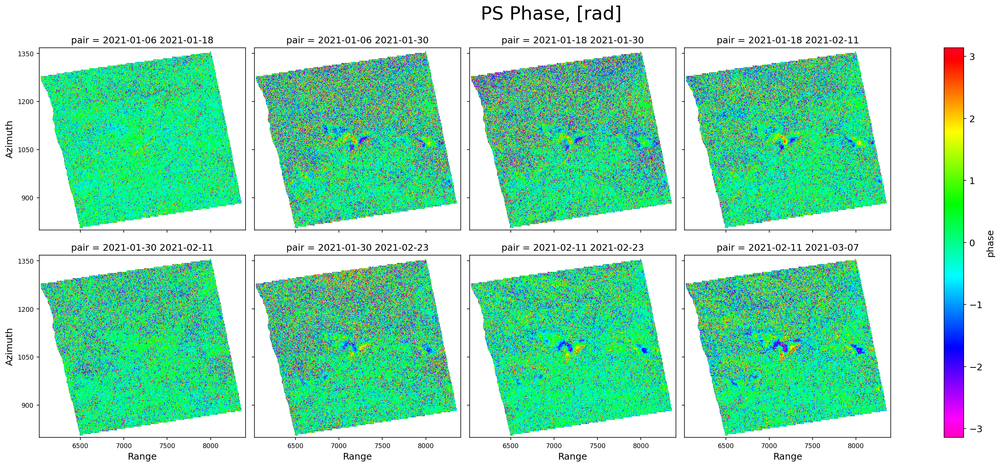

In [199]:
sbas.plot_interferograms(intf_ps[:8], caption='PS Phase, [rad]')

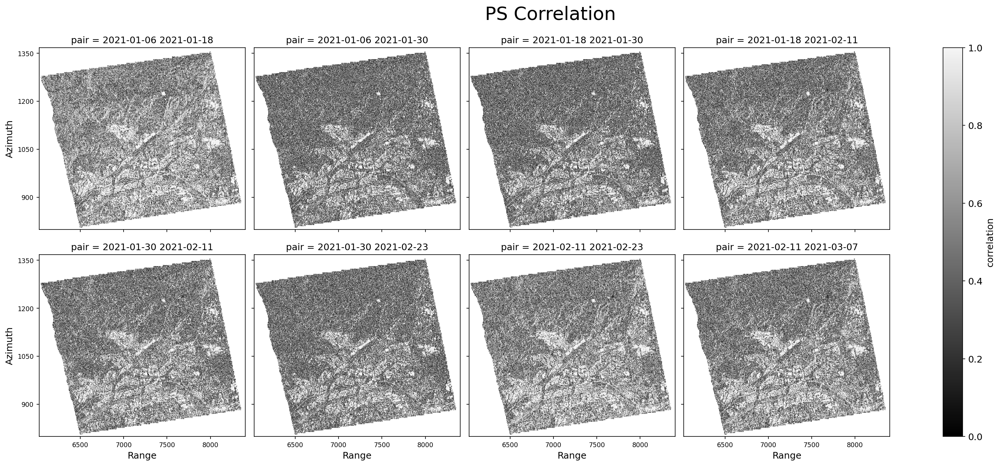

In [200]:
sbas.plot_correlations(corr_ps[:8], caption='PS Correlation')

### 1D Unwrapping and LOS Displacement, mm

In [201]:
disp_ps_pairs = sbas.los_displacement_mm(sbas.unwrap1d(intf_ps))
disp_ps_pairs

Note: data chunk size (569, 2048) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.DataArray 'los' (pair: 57, y: 569, x: 2376)> Size: 308MB
dask.array<multiply, shape=(57, 569, 2376), dtype=float32, chunksize=(57, 256, 256), chunktype=numpy.ndarray>
Coordinates:
  * pair     (pair) <U21 5kB '2021-01-06 2021-01-18' ... '2021-12-08 2021-12-20'
    ref      (pair) datetime64[ns] 456B dask.array<chunksize=(57,), meta=np.ndarray>
    rep      (pair) datetime64[ns] 456B dask.array<chunksize=(57,), meta=np.ndarray>
  * y        (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.366e+03 1.368e+03
  * x        (x) float64 19kB 6.026e+03 6.028e+03 ... 8.4e+03 8.402e+03

In [202]:
# optionally, materialize to disk and open
disp_ps_pairs = sbas.sync_cube(disp_ps_pairs, 'disp_ps_pairs')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [203]:
disp_ps = sbas.lstsq(disp_ps_pairs, corr_ps)
disp_ps

Note: data chunk size (569, 2048) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk: (256, 256)


<xarray.DataArray 'displacement' (date: 30, y: 569, x: 2376)> Size: 162MB
dask.array<concatenate, shape=(30, 569, 2376), dtype=float32, chunksize=(30, 256, 256), chunktype=numpy.ndarray>
Coordinates:
  * date     (date) datetime64[ns] 240B 2021-01-06 2021-01-18 ... 2021-12-20
  * y        (y) float64 5kB 799.5 800.5 801.5 ... 1.366e+03 1.366e+03 1.368e+03
  * x        (x) float64 19kB 6.026e+03 6.028e+03 ... 8.4e+03 8.402e+03

In [ ]:
# optionally, materialize to disk and open
disp_ps = sbas.sync_cube(disp_ps, 'disp_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
zmin, zmax = np.nanquantile(disp_ps, [0.01, 0.99])
sbas.plot_displacements(disp_ps[::3], caption='PS Cumulative LOS Displacement, [mm]', vmin=zmin, vmax=zmax)

### STL model for LOS Displacement, mm

In [ ]:
stl_ps = sbas.stl(disp_ps)
stl_ps

In [ ]:
# optionally, materialize to disk and open
stl_ps = sbas.sync_cube(stl_ps, 'stl_ps')

In [ ]:
years = ((stl_ps.date.max() - stl_ps.date.min()).dt.days/365.25).item()
print ('years', np.round(years, 3))
velocity_ps = stl_ps.trend.mean('date')/years
velocity_ps

In [ ]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_ps, [0.01, 0.99])

ax = fig.add_subplot(1, 2, 1)
velocity_ps.plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
sbas.geocode(AOI.buffer(-BUFFER).boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
sbas.geocode(POI0).plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.set_aspect('auto')
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry.buffer(-BUFFER))\
    .plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
AOI.buffer(-BUFFER).boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
POI0.plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('PS LOS Velocity STL Decompose, 2021', fontsize=18)
plt.tight_layout()
plt.show()

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = stl_ps.sel(y=y, x=x, method='nearest')
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = stl_ps.sel(y=y, x=x, method='nearest')
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title('PS LOS Displacement STL Decompose, 2021', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.show()

In [ ]:
x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
sbas.plot_baseline_displacement(disp_ps_pairs.sel(y=y, x=x, method='nearest')/sbas.los_displacement_mm(1),
                                corr_ps.sel(y=y, x=x, method='nearest'),
                               caption='POI0', stl=True)

In [ ]:
x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
sbas.plot_baseline_displacement(disp_ps_pairs.sel(y=y, x=x, method='nearest')/sbas.los_displacement_mm(1),
                                corr_ps.sel(y=y, x=x, method='nearest'),
                               caption='POI', stl=True)

In [ ]:
rmse = sbas.rmse(disp_ps_pairs, disp_ps, corr_ps)
rmse

In [ ]:
rmse.plot.imshow(cmap='turbo', vmin=0, vmax=0.3)
_ = plt.title('RMSE Correlation Aware', fontsize=18)

## SBAS vs PS Comparision

In [ ]:
# crop AOI
points_sbas = sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.clip(AOI.geometry)
points_ps = sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry)
points_ps = points_ps.interp_like(points_sbas, method='nearest').values.ravel()
points_sbas = points_sbas.values.ravel()
nanmask = np.isnan(points_sbas) | np.isnan(points_ps)
points_sbas = points_sbas[~nanmask]
points_ps = points_ps[~nanmask]

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)
plt.scatter(points_sbas, points_ps, c='silver', alpha=1,   s=1)
plt.scatter(points_sbas, points_ps, c='b',      alpha=0.1, s=1)
plt.scatter(points_sbas, points_ps, c='g',      alpha=0.1, s=0.1)
plt.scatter(points_sbas, points_ps, c='y',      alpha=0.1, s=0.01)

# adding a 1:1 line
max_value = max(velocity_sbas.max(), velocity_ps.max())
min_value = min(velocity_sbas.min(), velocity_ps.min())
plt.plot([min_value, max_value], [min_value, max_value], 'k--')

plt.xlabel('Velocity SBAS, mm/year', fontsize=16)
plt.ylabel('Velocity PS, mm/years', fontsize=16)
plt.title('Cross-Comparison between SBAS and PS Velocity', fontsize=18)
plt.grid(True)
plt.show()

## 3D Interactive Map

In [ ]:
dem = sbas.get_dem()

In [ ]:
velocity_sbas_ll = sbas.ra2ll(velocity_sbas)
velocity_ps_ll = sbas.ra2ll(velocity_ps)

velocity_sbas_ll = sbas.as_geo(velocity_sbas_ll).rio.clip(AOI.geometry.buffer(-BUFFER).envelope)
velocity_ps_ll = sbas.as_geo(velocity_ps_ll).rio.clip(AOI.geometry.buffer(-BUFFER).envelope)

In [ ]:
gmap_tiles = XYZTiles().download(velocity_sbas_ll, 14)

In [ ]:
for name, velocity_ll in {'sbas': velocity_sbas_ll, 'ps': velocity_ps_ll}.items():
    #sbas.as_geo(velocity_ll).rio.clip(AOI.geometry.buffer(-BUFFER))
    gmap = gmap_tiles.interp_like(velocity_ll, method='cubic').round().astype(np.uint8)

    zmin, zmax = np.nanquantile(velocity_ll, [0.01, 0.99])
    velocity_ll_norm = np.clip((velocity_ll - zmin) / (zmax - zmin), 0, 1)
    cmap = plt.cm.get_cmap('turbo')
    velocity_ll_colors = xr.DataArray(255*cmap(velocity_ll_norm)[..., :3].transpose(2,0,1), coords=gmap.coords)\
        .round().astype(np.uint8)\
        .rename('colors')
    mask_invert = sbas.as_geo(velocity_ll_colors).rio.clip(AOI.geometry.buffer(-BUFFER), invert=True)
    map_colors = xr.where(mask_invert.sum('band') == 0, velocity_ll_colors, gmap)
    ds = xr.merge([dem.interp_like(velocity_ll, method='cubic').rename('z'),
                   map_colors.transpose('band', 'lat', 'lon')])
    # decimate large grid
    ds = ds.sel(lat=ds.lat[::2])
    # convert to VTK structure
    vtk_grid = pv.StructuredGrid(NCubeVTK.ImageOnTopography(ds.rename({'lat': 'y', 'lon': 'x'})))
    vtk_grid.save(f'velocity_{name}.vtk')
vtk_grid

In [ ]:
plotter = pv.Plotter(shape=(1, 2), notebook=True)
axes = pv.Axes(show_actor=True, actor_scale=2.0, line_width=5)

plotter.subplot(0, 0)
vtk_grid = pv.read('velocity_sbas.vtk')
mesh = vtk_grid\
    .scale([1, 1, 0.00002], inplace=True)\
    .rotate_z(135, point=axes.origin, inplace=True)
plotter.add_mesh(mesh, scalars='colors', rgb=True, ambient=0.2)
plotter.show_axes()
plotter.add_title('SBAS LOS Velocity', font_size=32)

plotter.subplot(0, 1)
vtk_grid = pv.read('velocity_ps.vtk')
mesh = vtk_grid\
    .scale([1, 1, 0.00002], inplace=True)\
    .rotate_z(135, point=axes.origin, inplace=True)
plotter.add_mesh(mesh, scalars='colors', rgb=True, ambient=0.2)
plotter.show_axes()
plotter.add_title('PS LOS Velocity', font_size=32)

plotter.show_axes()
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

## Export VTK file from Google Colab

In [ ]:
if 'google.colab' in sys.modules:
    from google.colab import files
    files.download('velocity_sbas.vtk')
    files.download('velocity_ps.vtk')

# Elabora file output

In [ ]:
print(velocity_ps.shape)
#print(velocity_ps[:10])
print(zmin)
print(zmax)

plt.figure(figsize=(12, 4), dpi=300)

# subsidence point from
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [-118.4629,34.3946]
  },
  "properties": {}
}
'''
POI = gpd.GeoDataFrame.from_features([json.loads(geojson)])

points_sbas = sbas.as_geo(sbas.ra2ll(velocity_sbas))#.rio.clip(AOI.geometry)
points_ps = sbas.as_geo(sbas.ra2ll(velocity_ps))#.rio.clip(AOI.geometry)

print("Dimensione massima:", points_sbas.size)

max_lat = points_sbas['lat'].max()
min_lat = points_sbas['lat'].min()

max_lon = points_sbas['lon'].max()
min_lon = points_sbas['lon'].min()
print("Coordinate massime e minime:")
print("Latitudine massima:", max_lat.values)
print("Latitudine minima:", min_lat.values)
print("Longitudine massima:", max_lon.values)
print("Longitudine minima:", min_lon.values)

velocity_sbas_ll = sbas.ra2ll(velocity_sbas)
velocity_ps_ll = sbas.ra2ll(velocity_ps)
velocity_sbas_ll.to_dataframe().to_csv('/content/velocity_sbas_ll.csv')
velocity_ps_ll.to_dataframe().to_csv('/content/velocity_ps_ll.csv')
#velocity_sbas_ll.to_netcdf('/content/velocity_sbas_ll.nc')
#velocity_ps_ll.to_netcdf('/content/velocity_ps_ll.nc')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
print("Punto di interesse x={} e y={}".format(x, y))
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = stl_ps.sel(y=y, x=x, method='nearest')
#plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')

import pandas as pd

# Creazione di un DataFrame pandas
data = {'Data': disp_pixel.date, 'Displacement': disp_pixel}
df = pd.DataFrame(data)

print("Punto 0 Data={}; Displacement={}".format(df['Data'].iloc[0], df['Displacement'].iloc[0]))

# Stampa del DataFrame
#print(df)


for lat, lon in zip(velocity_ps_ll.coords['lat'].values, velocity_ps_ll.coords['lon'].values):
    valore = velocity_ps_ll.sel(lat=lat, lon=lon).values
    print("Punto di interesse lat={} e lon={}; valore={}".format(lat, lon, valore))
    exit


# Converti l'oggetto xarray.DataArray in un DataFrame pandas con coordinate separate
df_ll = velocity_ps_ll.reset_coords(drop=True).to_dataframe(name='valore')

# Visualizza il DataFrame
print(df_ll)

 ### trasforma files 'grd'

In [ ]:
from osgeo import gdal

# Percorso del file GRD di input
input_grd = "/content/raw_golden_desc/disp_ps.grd"

# Percorso del file XYZ di output
output_xyz = "/content/raw_golden_desc/disp_ps.xyz"

# Apri il file GRD
dataset = gdal.Open(input_grd)

# Leggi i dati del raster
data = dataset.ReadAsArray()

# Ottieni le informazioni sulle dimensioni del raster
cols = dataset.RasterXSize
rows = dataset.RasterYSize
print("Dimesioni raster rows={} e cols={}".format(rows, cols))

# Ottieni le informazioni sulla trasformazione geospaziale
geotransform = dataset.GetGeoTransform()

# Calcola l'estensione spaziale del raster
x_min = geotransform[0]
y_max = geotransform[3]
x_max = x_min + geotransform[1] * cols
y_min = y_max + geotransform[5] * rows

# Calcola la risoluzione del raster
x_resolution = geotransform[1]
y_resolution = geotransform[5]

# Scrivi i dati in formato XYZ
with open(output_xyz, "w") as outfile:
    for y in range(rows):
        for x in range(cols):
            # Calcola le coordinate del punto
            x_coord = x_min + (x + 0.5) * x_resolution
            y_coord = y_max - (y + 0.5) * y_resolution
            #print("Coordinate x_coord={} e y_coord={}".format(x_coord, y_coord))
            # Verifica che gli indici siano all'interno dei limiti dell'array
            if 0 <= y < len(data) and 0 <= x < len(data[y]):
                if not np.all(np.isnan(data[y][x])):
                    # Scrivi le coordinate e il valore del punto nel file XYZ
                    shape = data[y][x].shape
                    #print("Punto di interesse x={} e y={} Dimensioni di data[y][x]: {}".format(x, y, shape))
                    outfile.write(f"{x_coord} {y_coord} {data[y][x]}\n")
                else:
                    #print(f"Valore NaN trovato: y={y}, x={x}")
                    a = 1
            else:
                # Se gli indici sono al di fuori dei limiti, stampa un messaggio di avviso
                b = 1
                #print(f"Indici fuori dai limiti: y={y}, x={x}")

 ### elabora files 'vtk'

In [ ]:

import vtk

# Percorso del file VTK
file_vtk = '/content/velocity_ps.vtk'

# Coordinata (x, y) del punto di interesse
x = 1  # Coordinata x del punto di interesse
y = 1  # Coordinata y del punto di interesse

# Crea un lettore VTK per il file
reader = vtk.vtkStructuredGridReader()
reader.SetFileName(file_vtk)
reader.Update()

# Ottieni l'output del lettore
output = reader.GetOutput()

# Ottenere il numero di punti nel grid
num_points = output.GetNumberOfPoints()

# Cerca il punto di interesse
point_id = -1
for i in range(num_points):
    point = output.GetPoint(i)
    #print("Valore della coordinata x={}, y={}, z={}".format(point[0], point[1], point[2]))
    if point[0] == x and point[1] == y:
        point_id = i
        break

# Se il punto di interesse è stato trovato
if point_id != -1:
    # Ottieni il valore della coordinata z del punto di interesse
    z_value = output.GetPoint(point_id)[2]
    print("Valore della coordinata z per x={}, y={}: {}".format(x, y, z_value))
else:
    print("Punto di interesse non trovato per x={} e y={}".format(x, y))